In [1]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.colors import Normalize
import numpy as np
import h5py
import hdf5plugin

from crystfelparser.crystfelparser import streamfile_parser

def imgf_plot(img,ax,vmax=20):
    '''Just plot a diffraction image using matplotlib'''
    im=np.clip(img,0,10000)
    imlog=np.log(im+1)
    imlog=imlog/np.max(imlog)*255
    plt.imshow(imlog,cmap="gist_yarg",vmin=0,vmax=vmax)
    plt.axis('off')
    
# Function to visualize a frame with overlapped indexed pattern
def visualize_frame(h5_file, stream, frame_idx, cap_value=30):
    with h5py.File(h5_file, 'r') as f:
        # Get the frame data
        frame = f['/entry/data/data'][frame_idx]

        # Cap the frame values
        # frame = np.minimum(frame, cap_value)
        
        # Get the predicted reflections
        reflections = stream.parsed[frame_idx]['predicted_reflections'][:,:2]
        # Get the predicted reflections
        peaks = stream.parsed[frame_idx]['peaks'][:,:2]

        # Create a figure and axis to plot on
        fig, ax = plt.subplots(figsize=(25,25),dpi=200)

        # Display the image
        #ax.imshow(frame, cmap='gray_r', norm=Normalize(vmin=0, vmax=cap_value))
        imgf_plot(frame,ax,vmax=cap_value)
        
        # Add circles for each reflection
        for x, y in reflections:
            # Create a circle at (x, y) with radius 5
            circ = patches.Circle((x, y), 12, fill=False, edgecolor='r')
            ax.add_patch(circ)
            
        # Add circles for each spots
        for x, y in peaks:
            # Create a circle at (x, y) with radius 5
            circ = patches.Circle((x, y), 8, fill=False, edgecolor='g')
            ax.add_patch(circ)

        # Show the plot
        plt.show()


In [6]:
!ls *stream

KR2_LB_YESALL_000001.stream  KR2_LB_YESALL_000007.stream
KR2_LB_YESALL_000002.stream  KR2_LB_YESALL_000008.stream
KR2_LB_YESALL_000003.stream  KR2_LB_YESALL_000009.stream
KR2_LB_YESALL_000004.stream  KR2_LB_YESALL_000010.stream
KR2_LB_YESALL_000005.stream  KR2_yesall_XGANDALF.stream
KR2_LB_YESALL_000006.stream  log.KR2_yesall_XGANDALF.stream


In [74]:
from crystfelparser.crystfelparser import streamfile_parser
h5_file = "/das/work/p16/p16371/MAXIV/20211201/raw/KR2/KR2-dark3/KR2-dark3_28_data_000001.h5"
#h5_file = "/das/work/p16/p16371/MAXIV/20211201/raw/Lyso/Lyso-2kHz/Lyso-2kHz_1_data_000001.h5"
stream_file = "KR2_LB_YESALL_000001.stream"
#stream_file = "/das/work/p19/p19607/FromGreta/REDML_indx_data/Lyso-2kHz/XGandalf/Lyso_XGandalf_NOALL_000001.stream"

stream = streamfile_parser(stream_file)
indexable_frames = stream.get_indexable_frames()


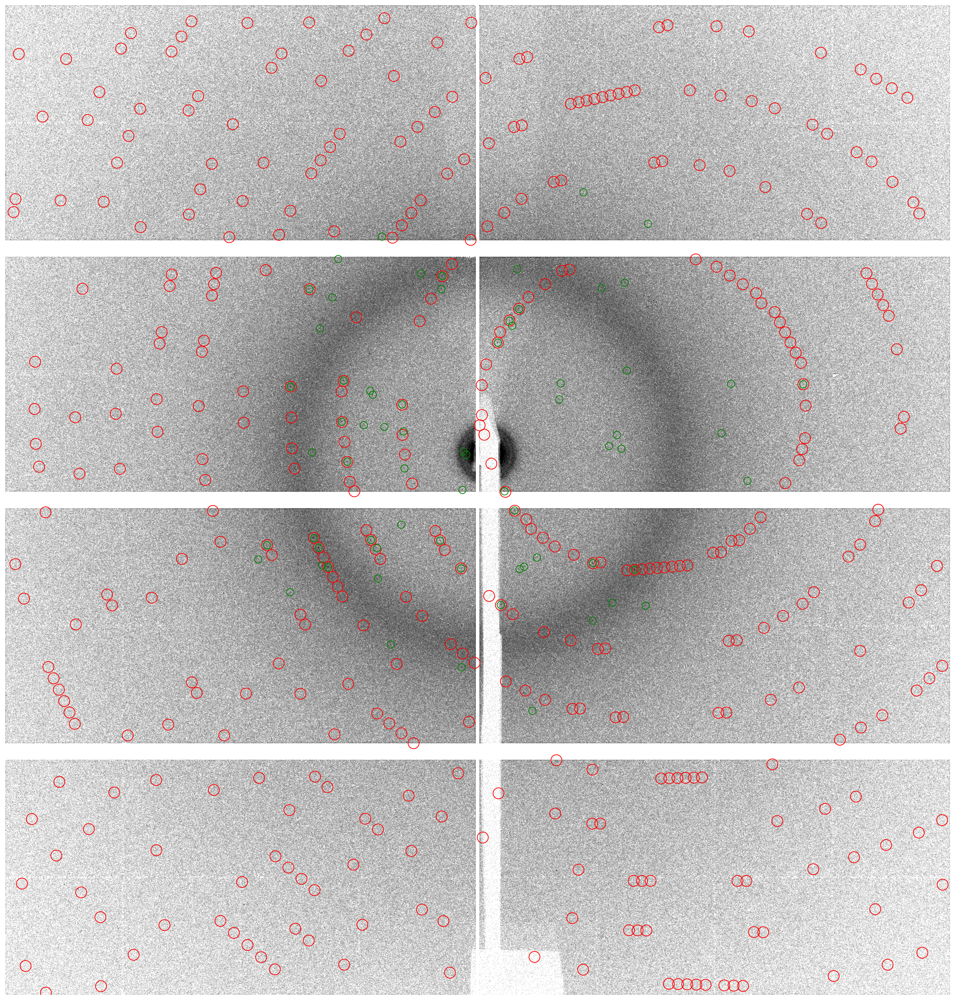

In [76]:
#user_select_frame(h5_file, stream, indexable_frames)
visualize_frame(h5_file, stream, indexable_frames[10], cap_value=85)

In [2]:
def imgf_plot(img,ax,vmax=20):
    '''Just plot a diffraction image using matplotlib'''
    im=np.clip(img,0,10000)
    imlog=np.log(im+1)
    imlog=imlog/np.max(imlog)*255
    plt.imshow(imlog,cmap="gist_yarg",vmin=0,vmax=vmax)
    plt.axis('off')
    
# Function to visualize a frame with overlapped indexed pattern
def visualize_frame_only(h5_file, frame_idx, cap_value=30):
    with h5py.File(h5_file, 'r') as f:
        # Get the frame data
        frame = f['/entry/data/data'][frame_idx]

        # Cap the frame values
        # frame = np.minimum(frame, cap_value)

        # Create a figure and axis to plot on
        fig, ax = plt.subplots(figsize=(25,25),dpi=200)

        # Display the image
        #ax.imshow(frame, cmap='gray_r', norm=Normalize(vmin=0, vmax=cap_value))
        imgf_plot(frame,ax,vmax=cap_value)

        # Show the plot
        plt.show()
        
def visualize_frame_compr(h5_file, stream, frame_idx, cap_value=30):
    with h5py.File(h5_file, 'r') as f:
        # Get the frame data
        frame = f['/entry/data/data'][frame_idx]

        # Cap the frame values
        # frame = np.minimum(frame, cap_value)
        
        indexable_frames = stream.get_indexable_frames()
        
        # Get the predicted reflections
        reflections = stream.parsed[indexable_frames[frame_idx]]['predicted_reflections'][:,:2]
        # Get the predicted reflections
        peaks = stream.parsed[indexable_frames[frame_idx]]['peaks'][:,:2]

        # Create a figure and axis to plot on
        fig, ax = plt.subplots(figsize=(25,25),dpi=200)

        # Display the image
        #ax.imshow(frame, cmap='gray_r', norm=Normalize(vmin=0, vmax=cap_value))
        imgf_plot(frame,ax,vmax=cap_value)
        
        # Add circles for each reflection
        for x, y in reflections:
            # Create a circle at (x, y) with radius 5
            circ = patches.Circle((x, y), 12, fill=False, edgecolor='r')
            ax.add_patch(circ)
            
        # Add circles for each spots
        for x, y in peaks:
            # Create a circle at (x, y) with radius 5
            circ = patches.Circle((x, y), 8, fill=False, edgecolor='g')
            ax.add_patch(circ)

        # Show the plot
        plt.show()

In [3]:
stream_file = "KR2_LB_YESALL_000001.stream"
#stream_file = "/das/work/p19/p19607/FromGreta/REDML_indx_data/Lyso-2kHz/XGandalf/Lyso_XGandalf_NOALL_000001.stream"

stream = streamfile_parser(stream_file)

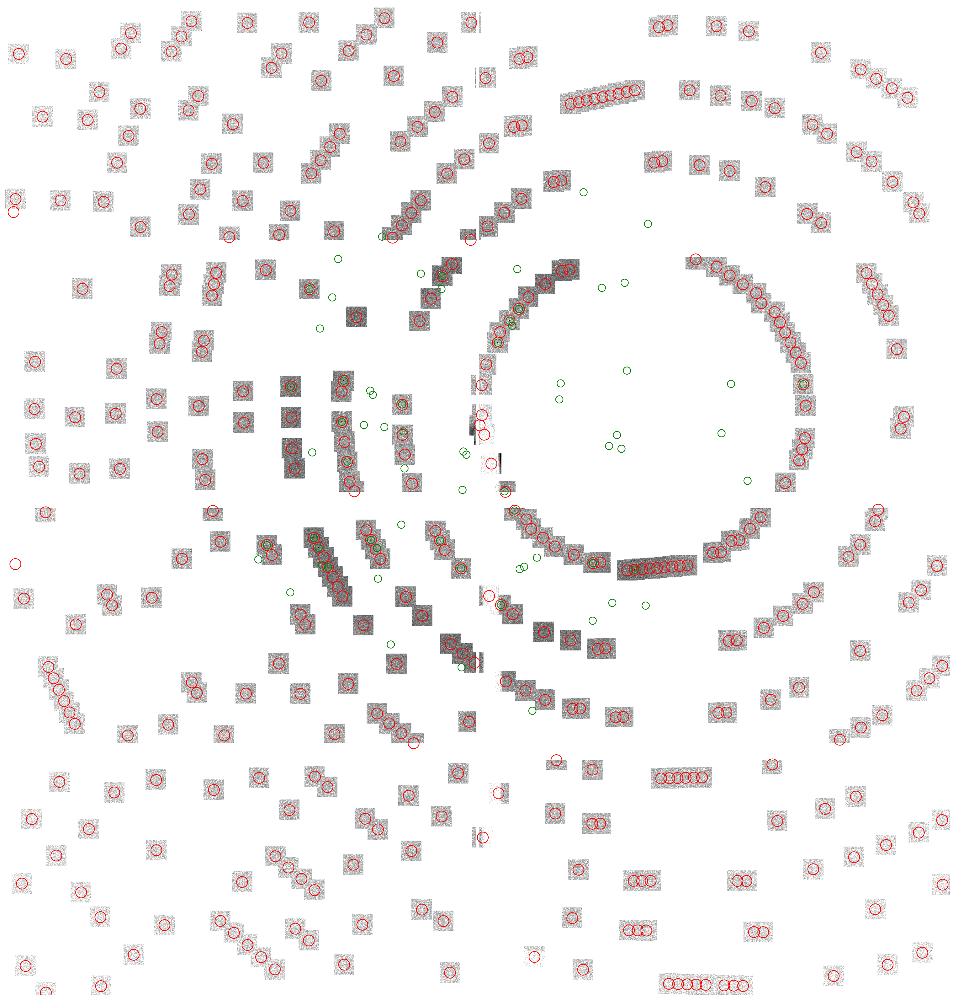

In [4]:
h5_file = "KR2_LB_YESALL_000001_sparse_compressed.h5"
visualize_frame_compr(h5_file, stream, 10, cap_value=90)